# Deconvolute the mouse brain data (Fig 3d-g)

## Prepare single-cell reference data

In [1]:
import warnings
import scanpy as sc
import anndata as ad
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

### Load single-cell reference

In [2]:
data_dir = "/Users/jysumac/Projects/Smoother_paper/data/mouse_brain_visium/"
sample_id_list = ['5705STDY8058280', '5705STDY8058281', '5705STDY8058282']

adata_list = []
for s_id in sample_id_list:
    _ad = sc.read_10x_h5(f"{data_dir}/scref/{s_id}_filtered_feature_bc_matrix.h5")
    _ad.var_names_make_unique()
    _ad.obs['sample_id'] = s_id
    _ad.obs['cell_id'] = _ad.obs['sample_id'] + '_' +  _ad.obs_names
    adata_list.append(_ad)


scref = ad.concat(adata_list)
scref.obs = scref.obs.set_index('cell_id')

del adata_list

/Users/jysumac/miniforge3/envs/sp_dev/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/Users/jysumac/miniforge3/envs/sp_dev/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/Users/jysumac/miniforge3/envs/sp_dev/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/Users/jysumac/miniforge3/envs/sp_dev/lib/python3.9/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


#### Add cell type annotation

In [3]:
# load cell type annotation
ct_anno = pd.read_csv(
    data_dir + "/scref/cell_annotation.csv",
    sep = ',', header = 0
)
ct_anno.columns = ['cell_id', 'sample_id', 'cell_type', 'cel_type_print']
ct_anno.set_index('cell_id', inplace = True)

# add to meta
scref.obs = pd.merge(scref.obs, ct_anno, how = 'left', on = ['cell_id', 'sample_id'])
scref = scref[~scref.obs['cell_type'].isna()]

# remove unknown and low-qual cell types
ct_to_remove = ['Unk_1', 'Unk_2', 'Ext_Unk_1', 'Ext_Unk_2', 'Ext_Unk_3', 'LowQ_1', 'LowQ_2']
scref = scref[~scref.obs['cell_type'].isin(ct_to_remove)]

In [4]:
scref.obs['cell_type'].unique(), len(scref.obs['cell_type'].unique())

(array(['Ext_L25', 'Ext_L56', 'Ext_Thal_1', 'Ext_L5_1', 'Ext_Thal_2',
        'Ext_L23', 'Oligo_2', 'Inh_1', 'Ext_Hpc_DG2', 'OPC_1', 'Inh_Sst',
        'Ext_L6', 'Inh_Meis2_2', 'Inh_3', 'Ext_Pir', 'Ext_L5_3', 'Inh_4',
        'Ext_Hpc_DG1', 'Inh_Lamp5', 'Astro_STR', 'Astro_CTX', 'Nb_1',
        'Inh_Meis2_4', 'Inh_Meis2_3', 'Inh_Pvalb', 'Micro', 'OPC_2',
        'Astro_AMY', 'Oligo_1', 'Inh_6', 'Ext_Amy_2', 'Astro_THAL_lat',
        'Inh_Meis2_1', 'Astro_AMY_CTX', 'Ext_L6B', 'Ext_L5_2',
        'Ext_Hpc_CA1', 'Inh_Vip', 'Astro_THAL_med', 'Astro_HYPO', 'Inh_2',
        'Ext_Hpc_CA3', 'Ext_ClauPyr', 'Nb_2', 'Ext_Med', 'Astro_HPC',
        'Ext_Hpc_CA2', 'Astro_WM', 'Inh_5', 'Astro_THAL_hab', 'Ext_Amy_1',
        'Endo'], dtype=object),
 52)

#### QC

In [5]:
sc.pp.filter_cells(scref, min_genes=200)
sc.pp.filter_genes(scref, min_cells=10)

/Users/jysumac/miniforge3/envs/sp_dev/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:140: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['n_genes'] = number


In [6]:
scref.var['mt'] = scref.var_names.str.startswith('mt-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(scref, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

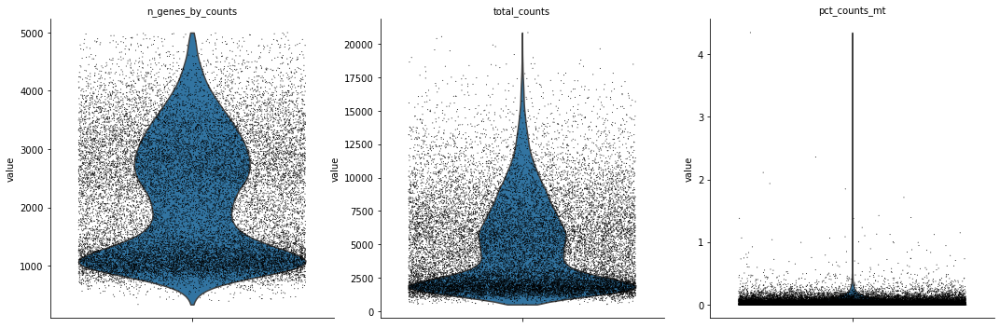

In [7]:
sc.pl.violin(scref, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)

#### Visualization

In [8]:
scref.layers['raw'] = scref.X.copy()
sc.pp.normalize_total(scref, target_sum=1e4)
scref.layers['norm'] = scref.X.copy()
sc.pp.log1p(scref)
sc.pp.highly_variable_genes(scref)
scref.raw = scref
sc.pp.scale(scref, max_value=10)

In [9]:
sc.tl.pca(scref, svd_solver='arpack')
sc.pp.neighbors(scref, n_neighbors=10, n_pcs=40)
sc.tl.umap(scref)

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


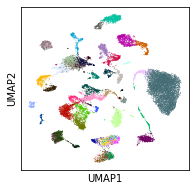

In [10]:
with plt.rc_context({"figure.figsize": (3, 3)}):
    sc.pl.umap(scref, color='cell_type', legend_loc = None, title = '', size = 2)

### Extract marker genes and prepare inputs

In [11]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    sc.tl.rank_genes_groups(scref, 'cell_type', method='wilcoxon')
    markers_df = sc.get.rank_genes_groups_df(scref, group = None,
                                             pval_cutoff = 0.01, log2fc_min = 1)

In [12]:
markers_df

,group,names,scores,logfoldchanges,pvals,pvals_adj
0,Astro_AMY,Wdr17,22.726244,6.087364,2.465425e-114,5.412842e-110
1,Astro_AMY,Apoe,22.672453,5.650846,8.379271e-114,9.198345e-110
2,Astro_AMY,Slc1a2,22.538107,5.732259,1.756718e-112,1.285625e-108
3,Astro_AMY,Gpc5,22.155388,6.397170,9.256068e-109,5.080424e-105
4,Astro_AMY,Slc1a3,21.987389,5.580466,3.802537e-107,1.669694e-103
...,...,...,...,...,...,...
39656,Oligo_2,Efna1,2.840546,2.943818,4.503643e-03,8.852058e-03
39657,Oligo_2,Slc45a3,2.837178,4.441612,4.551427e-03,8.941176e-03
39658,Oligo_2,Tshb,2.820780,3.290090,4.790712e-03,9.394434e-03
39659,Oligo_2,Vamp5,2.819634,2.044873,4.807838e-03,9.425492e-03


#### All informative genes

In [13]:
markers_nm0 = markers_df.pivot_table(index='names', columns='group',
                                     values='logfoldchanges', fill_value=0)
markers_nm0 = markers_nm0.loc[((markers_nm0 >= 1).sum(1) < 10),:]

print(markers_nm0.shape)
markers_nm0.to_csv(f"{data_dir}/scref/markers_nm0.csv")

(6525, 52)


#### Top50 marker genes

In [14]:
markers_nm50 = markers_df.sort_values(['group', 'logfoldchanges'],
                                    ascending=False).groupby('group').head(50)
markers_nm50 = markers_nm50.pivot_table(index='names', columns='group',
                                    values='logfoldchanges', fill_value=0)
print(markers_nm50.shape)
markers_nm50.to_csv(f"{data_dir}/scref/markers_nm50.csv")

(1459, 52)


#### Top20 marker genes

In [15]:
markers_nm20 = markers_df.sort_values(['group', 'logfoldchanges'],
                                    ascending=False).groupby('group').head(20)
markers_nm20 = markers_nm20.pivot_table(index='names', columns='group',
                                    values='logfoldchanges', fill_value=0)
print(markers_nm20.shape)
markers_nm20.to_csv(f"{data_dir}/scref/markers_nm20.csv")

(733, 52)


### Save data

#### H5 object

In [16]:
scref.write(f"{data_dir}/scref/scref_with_ct_mks.h5ad", compression = 'gzip')

In [17]:
scref

AnnData object with n_obs × n_vars = 21013 × 21955
    obs: 'sample_id', 'cell_type', 'cel_type_print', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'cell_type_colors', 'rank_genes_groups'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'raw', 'norm'
    obsp: 'distances', 'connectivities'

#### Averaged expression profiles

In [18]:
from smoother.simulation.utils import grouped_obs_mean
ref_exp = grouped_obs_mean(scref, group_key='cell_type', layer = 'norm')

In [19]:
ref_exp_m = ref_exp.loc[markers_nm0.index,:]
ref_exp_m.to_csv(f"{data_dir}/scref/ref_avg_count_nm0.csv")
np.log1p(ref_exp_m).to_csv(f"{data_dir}/scref/ref_avg_logcount_nm0.csv")

In [20]:
ref_exp_m = ref_exp.loc[markers_nm50.index,:]
ref_exp_m.to_csv(f"{data_dir}/scref/ref_avg_count_nm50.csv")
np.log1p(ref_exp_m).to_csv(f"{data_dir}/scref/ref_avg_logcount_nm50.csv")

In [21]:
ref_exp_m = ref_exp.loc[markers_nm20.index,:]
ref_exp_m.to_csv(f"{data_dir}/scref/ref_avg_count_nm20.csv")
np.log1p(ref_exp_m).to_csv(f"{data_dir}/scref/ref_avg_logcount_nm20.csv")

## Deconvolute a single slide

In [1]:
import warnings
import os
import itertools
import torch
import numpy as np
import pandas as pd
import scipy as sp
import scanpy as sc
import anndata as ad

import smoother
from smoother import SpatialWeightMatrix, SpatialLoss
from smoother.models.deconv import LinearRegression, NNLS, NuSVR, DWLS, LogNormReg

import matplotlib
import matplotlib.pyplot as plt
from plotnine import *

In [2]:
from matplotlib.image import imread
import json

def read_sp_data(data_dir, sample_id):
    count_dir = f"{data_dir}/ST/{sample_id}/{sample_id}_filtered_feature_bc_matrix.h5"
    sp_dir = f"{data_dir}/ST/{sample_id}/spatial/"
    
    # load counts
    adata = sc.read_10x_h5(count_dir)
    adata.var_names_make_unique()
    
    # load spatial data
    adata.uns["spatial"] = dict()
    adata.uns["spatial"][sample_id] = dict()

    files = dict(
        tissue_positions_file = sp_dir + '/tissue_positions_list.csv',
        scalefactors_json_file = sp_dir + '/scalefactors_json.json',
        hires_image = sp_dir + '/tissue_hires_image.png',
        lowres_image = sp_dir  + '/tissue_lowres_image.png',
    )

    adata.uns["spatial"][sample_id]['images'] = dict()

    for res in ['hires', 'lowres']:
        try:
            adata.uns["spatial"][sample_id]['images'][res] = imread(
                str(files[f'{res}_image'])
            )
        except Exception:
            raise OSError(f"Could not find '{res}_image'")

    # read json scalefactors
    with open(files['scalefactors_json_file']) as f:
        js = json.load(f)
    adata.uns["spatial"][sample_id]['scalefactors'] = js

    # read coordinates
    positions = pd.read_csv(files['tissue_positions_file'], header=None)
    positions.columns = [
        'barcode',
        'in_tissue',
        'array_row',
        'array_col',
        'pxl_col_in_fullres',
        'pxl_row_in_fullres',
    ]
    positions.index = positions['barcode']

    adata.obs = adata.obs.join(positions, how="left")

    adata.obsm['spatial'] = adata.obs[
        ['pxl_row_in_fullres', 'pxl_col_in_fullres']
    ].to_numpy()
    adata.obs.drop(
        columns=['barcode', 'pxl_row_in_fullres', 'pxl_col_in_fullres'],
        inplace=True,
    )
    
    return adata

### Load spatial data

In [3]:
data_dir = "/Users/jysumac/Projects/Smoother_paper/data/mouse_brain_visium/"
sample_id = "ST8059048"
sp_data = read_sp_data(data_dir, sample_id)
sc.pp.filter_genes(sp_data, min_cells=10)

/Users/jysumac/miniforge3/envs/sp_dev/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.


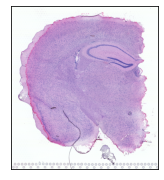

In [4]:
with plt.rc_context({"figure.figsize": (3, 3)}):
    axes = sc.pl.spatial(sp_data, size=2, show = False)
    axes[0].set_xlabel('')
    axes[0].set_ylabel('')
    plt.show()

### Prepare inputs and spatial loss

In [5]:
# change the data directory accordingly
data_dir = "/Users/jysumac/Projects/Smoother_paper/data/mouse_brain_visium/"

# read in log_count matrices
# reference count matrix, num_gene x num_celltype
lc_x = pd.read_csv(f"{data_dir}/scref/ref_avg_logcount_nm20.csv", header=0, index_col=0)

gene_selected = pd.Series(list(set(sp_data.var_names) & set(lc_x.index)))
x = torch.tensor(lc_x.loc[gene_selected,:].values).float()

# spatial counts
yc = sp_data[:,gene_selected].X.toarray().T
y = torch.tensor(np.log1p(yc)).float()

# spatial coordinates, num_spot x 2
# here we are using 10x Visium's pixel-level coordinates
# i.e., 'pxl_col_in_fullres' and 'pxl_row_in_fullres'
coords = sp_data.obsm['spatial']

In [6]:
# calculate spatial weight matrix
weights = SpatialWeightMatrix()
weights.calc_weights_knn(coords, k=6)

# scale the spatial weight matrix by transcriptional similarity
weights.scale_by_expr(y)

# convert spatial weight into loss
spatial_loss = SpatialLoss('icar', weights, rho=0.99, standardize_cov=True)

Number of spots: 2987. Average number of neighbors per spot:  5.85.
Number of spots: 2987. Average number of neighbors per spot:  5.85.


### Run deconvolution

In [7]:
torch.manual_seed(20220718)

deconv_configs = {'lr':1e-2, 'tol':1e-5, 'max_epochs':-1, 'verbose':False}
l_sp_list = [0, 0.3, 1, 3]
deconv_models = []

for l_sp in l_sp_list:
    model = NNLS()
    model.deconv(x, y, spatial_loss = spatial_loss, 
                 lambda_spatial_loss = l_sp, **deconv_configs)
    deconv_models.append(model)

p_inf_list = [m.get_props() for m in deconv_models]

=== Time  4.65s. Total epoch 729. Final loss: (total) 0.199. (spatial) 0.000.
=== Time  5.90s. Total epoch 727. Final loss: (total) 0.199. (spatial) 0.000.
=== Time  5.68s. Total epoch 723. Final loss: (total) 0.199. (spatial) 0.000.
=== Time  5.68s. Total epoch 717. Final loss: (total) 0.200. (spatial) 0.001.


### Visualize results

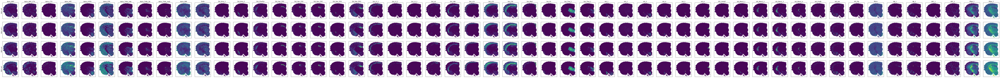

In [8]:
l_sp_list = [0, 0.3, 1, 3]
method_names = [f"NNLS_sp{str(l_sp)}" for l_sp in l_sp_list]
n_method = len(l_sp_list)
n_ct = lc_x.shape[1]
fig, axes = plt.subplots(n_method, n_ct, figsize = (3*n_ct, 3*n_method))

for row_id, (p_inf, name) in enumerate(zip(p_inf_list, method_names)): 
    axes[row_id][0].set_ylabel(name)
    for i in range(n_ct):
        if row_id == 0:
            axes[row_id][i].set_title(f"{lc_x.columns[i]}")

        axes[row_id][i].scatter(coords[:,0], - coords[:,1], c = p_inf[:, i], s = 3)

for ax in axes.flatten():
    ax.set_xticks([])
    ax.set_yticks([])

plt.show()

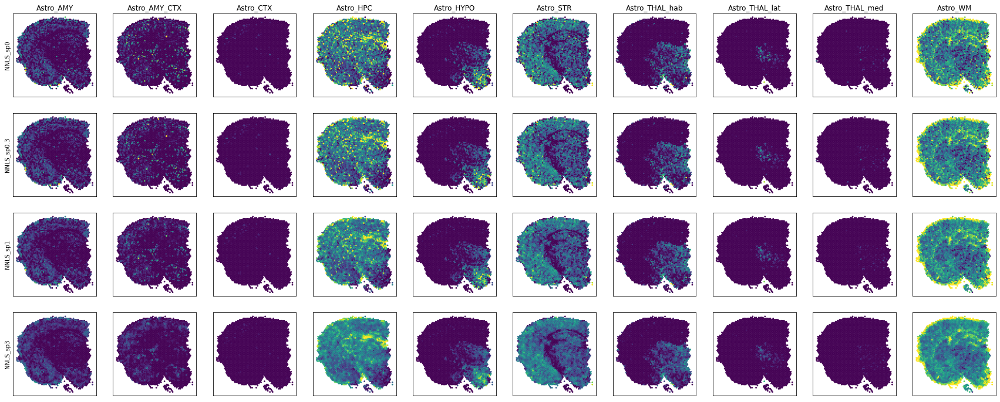

In [9]:
# Astrocytes
l_sp_list = [0, 0.3, 1, 3]
method_names = [f"NNLS_sp{str(l_sp)}" for l_sp in l_sp_list]
ct_to_plot = [f'Astro_{loc}' for loc in ['AMY', 'AMY_CTX', 'CTX', 'HPC', 'HYPO',
                                         'STR', 'THAL_hab', 'THAL_lat', 'THAL_med', 'WM']]
ct_idx = [np.where(lc_x.columns == ct)[0][0] for ct in ct_to_plot]

n_method = len(l_sp_list)
n_ct = len(ct_to_plot)
fig, axes = plt.subplots(n_method, n_ct, figsize = (3*n_ct, 3*n_method))

for row_id, (p_inf, name) in enumerate(zip(p_inf_list, method_names)): 
    axes[row_id][0].set_ylabel(name)
    for i in range(n_ct):
        if row_id == 0:
            axes[row_id][i].set_title(f"{ct_to_plot[i]}")

        axes[row_id][i].scatter(coords[:,0], - coords[:,1], c = p_inf[:, ct_idx[i]], s = 3, vmin=0, vmax=0.2)

for ax in axes.flatten():
    ax.set_xticks([])
    ax.set_yticks([])

plt.show()

## Deconvolute all slides

In [1]:
import warnings
import os
import itertools
import torch
import numpy as np
import pandas as pd
import scipy as sp
import scanpy as sc
import anndata as ad
import smoother
from smoother import SpatialWeightMatrix, SpatialLoss
from smoother.models.deconv import LinearRegression, NNLS, NuSVR, DWLS, LogNormReg
import matplotlib
import matplotlib.pyplot as plt
from plotnine import *

In [2]:
from matplotlib.image import imread
import json

def read_sp_data(data_dir, sample_id):
    count_dir = f"{data_dir}/ST/{sample_id}/{sample_id}_filtered_feature_bc_matrix.h5"
    sp_dir = f"{data_dir}/ST/{sample_id}/spatial/"
    
    # load counts
    adata = sc.read_10x_h5(count_dir)
    adata.var_names_make_unique()
    
    # load spatial data
    adata.uns["spatial"] = dict()
    adata.uns["spatial"][sample_id] = dict()

    files = dict(
        tissue_positions_file = sp_dir + '/tissue_positions_list.csv',
        scalefactors_json_file = sp_dir + '/scalefactors_json.json',
        hires_image = sp_dir + '/tissue_hires_image.png',
        lowres_image = sp_dir  + '/tissue_lowres_image.png',
    )

    adata.uns["spatial"][sample_id]['images'] = dict()

    for res in ['hires', 'lowres']:
        try:
            adata.uns["spatial"][sample_id]['images'][res] = imread(
                str(files[f'{res}_image'])
            )
        except Exception:
            raise OSError(f"Could not find '{res}_image'")

    # read json scalefactors
    with open(files['scalefactors_json_file']) as f:
        js = json.load(f)
    adata.uns["spatial"][sample_id]['scalefactors'] = js

    # read coordinates
    positions = pd.read_csv(files['tissue_positions_file'], header=None)
    positions.columns = [
        'barcode',
        'in_tissue',
        'array_row',
        'array_col',
        'pxl_col_in_fullres',
        'pxl_row_in_fullres',
    ]
    positions.index = positions['barcode']

    adata.obs = adata.obs.join(positions, how="left")

    adata.obsm['spatial'] = adata.obs[
        ['pxl_row_in_fullres', 'pxl_col_in_fullres']
    ].to_numpy()
    adata.obs.drop(
        columns=['barcode', 'pxl_row_in_fullres', 'pxl_col_in_fullres'],
        inplace=True,
    )
    
    return adata

In [3]:
from functools import partial

def prepare_sp_inputs(data_dir, sample_id, log1p=True, nm='20'):
    sp_data = read_sp_data(data_dir, sample_id)
    sc.pp.filter_genes(sp_data, min_cells=10)

    if log1p:
        lc_x = pd.read_csv(f"{data_dir}/scref/ref_avg_logcount_nm{nm}.csv", header=0, index_col=0)
    else:
        lc_x = pd.read_csv(f"{data_dir}/scref/ref_avg_count_nm{nm}.csv", header=0, index_col=0)

    gene_selected = pd.Series(list(set(sp_data.var_names) & set(lc_x.index)))
    x = torch.tensor(lc_x.loc[gene_selected,:].values).float()

    # spatial counts
    yc = sp_data[:,gene_selected].X.toarray().T

    if log1p:
        y = torch.tensor(np.log1p(yc)).float()
    else:
        y = torch.tensor(yc).float()

    coords = sp_data.obsm['spatial']

    return x, y, coords


def deconv_all_slides(data_dir, sample_id_list, log1p=True, nm='20'):
    torch.manual_seed(20220722)

    p_inf_sample_list = []
    runtime_sample_list = []
    
    deconv_configs = {'lr':1e-2, 'tol':1e-5, 'max_epochs':-1, 'verbose':False}
    l_sp_list = [0, 0.3, 1]
    method_names = [f"nnls_sp{str(l_sp)}" for l_sp in l_sp_list] + \
                    [f"dwls_sp{str(l_sp)}" for l_sp in l_sp_list]
    method_inits = [partial(NNLS), partial(DWLS, nonneg=True, max_weights=4)]

    for sample_id in sample_id_list:
        print(f"Deconvoluting sample {sample_id} ...")
        x, y, coords = prepare_sp_inputs(data_dir, sample_id, log1p, nm)
        
        # calculate spatial weight matrix
        weights = SpatialWeightMatrix()
        weights.calc_weights_knn(coords, k=6)

        # scale the spatial weight matrix by transcriptional similarity
        weights.scale_by_expr(y)

        # convert spatial weight into loss
        spatial_loss = SpatialLoss('icar', weights, rho=0.99)
        
        # run deconvolution
        deconv_models = []
        
        for m_init in method_inits:
            for l_sp in l_sp_list:
                model = m_init()
                model.deconv(x, y, spatial_loss=spatial_loss,
                             lambda_spatial_loss=l_sp, **deconv_configs)
                deconv_models.append(model)

        p_inf = [m.get_props().numpy() for m in deconv_models]
        p_inf_sample_list.append(np.stack(p_inf))
        
        # extract runtime
        runtime = [m.deconv_time for m in deconv_models]
        runtime_sample_list.append(np.stack(runtime))
        
    return method_names, p_inf_sample_list, runtime_sample_list

def save_deconv_results(res_dir, method_names, sample_id_list, p_inf_list, runtime_list):   
    assert len(p_inf_list) == len(runtime_list)

    if not os.path.exists(res_dir):
        os.makedirs(res_dir)
    
    runtime_df = pd.DataFrame(np.stack(runtime_list),
                              columns=method_names,
                              index = sample_id_list)
    runtime_df.to_csv(res_dir + "/runtime.csv")

    for i, sample_id in enumerate(sample_id_list):
        for m, name in enumerate(method_names):
            # check output folder
            file_dir = res_dir + f"/{sample_id}/"
            if not os.path.exists(file_dir):
                os.makedirs(file_dir)

            # save results
            np.savetxt(file_dir + f"/{name}.txt", p_inf_list[i][m,:,:])
    

### Run deconvolution

In [13]:
data_dir = "/Users/jysumac/Projects/Smoother_paper/data/mouse_brain_visium/"
res_dir = "/Users/jysumac/Projects/Smoother_paper/results/mouse_brain_visium/"
s_id_list = ["ST8059048", "ST8059049", "ST8059050"]

for nm in ['20', '50', '0', 'c']:
    res_nm_dir = f"{res_dir}/nm{nm}/"
    method_names, p_inf_sample_list, runtime_sample_list = deconv_all_slides(data_dir, s_id_list, nm=nm)
    save_deconv_results(res_nm_dir, method_names, s_id_list,
                        p_inf_sample_list, runtime_sample_list)

Deconvoluting sample ST8059048 ...


/Users/jysumac/miniforge3/envs/sp_dev/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.


Number of spots: 2987. Average number of neighbors per spot:  5.85.
Number of spots: 2987. Average number of neighbors per spot:  5.85.
=== Time  4.41s. Total epoch 723. Final loss: (total) 0.199. (spatial) 0.000.
=== Time  5.54s. Total epoch 727. Final loss: (total) 0.199. (spatial) 0.000.
=== Time  5.41s. Total epoch 719. Final loss: (total) 0.200. (spatial) 0.001.
=== Time  9.29s. Total epoch 893. Final loss: (total) 0.632. (spatial) 0.000.
=== Time  10.82s. Total epoch 881. Final loss: (total) 0.632. (spatial) 0.000.
=== Time  10.67s. Total epoch 887. Final loss: (total) 0.633. (spatial) 0.001.
Deconvoluting sample ST8059049 ...


/Users/jysumac/miniforge3/envs/sp_dev/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.


Number of spots: 3499. Average number of neighbors per spot:  5.87.
Number of spots: 3499. Average number of neighbors per spot:  5.87.
=== Time  4.41s. Total epoch 695. Final loss: (total) 0.170. (spatial) 0.000.
=== Time  5.85s. Total epoch 695. Final loss: (total) 0.170. (spatial) 0.000.
=== Time  5.82s. Total epoch 689. Final loss: (total) 0.170. (spatial) 0.001.
=== Time  9.93s. Total epoch 863. Final loss: (total) 0.535. (spatial) 0.000.
=== Time  11.39s. Total epoch 855. Final loss: (total) 0.535. (spatial) 0.000.
=== Time  11.35s. Total epoch 851. Final loss: (total) 0.536. (spatial) 0.001.
Deconvoluting sample ST8059050 ...


/Users/jysumac/miniforge3/envs/sp_dev/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.


Number of spots: 3497. Average number of neighbors per spot:  5.85.
Number of spots: 3497. Average number of neighbors per spot:  5.85.
=== Time  3.94s. Total epoch 635. Final loss: (total) 0.189. (spatial) 0.000.
=== Time  5.05s. Total epoch 631. Final loss: (total) 0.189. (spatial) 0.000.
=== Time  5.21s. Total epoch 623. Final loss: (total) 0.190. (spatial) 0.001.
=== Time  8.73s. Total epoch 781. Final loss: (total) 0.596. (spatial) 0.000.
=== Time  10.24s. Total epoch 785. Final loss: (total) 0.597. (spatial) 0.000.
=== Time  9.98s. Total epoch 761. Final loss: (total) 0.598. (spatial) 0.001.
Deconvoluting sample ST8059048 ...


/Users/jysumac/miniforge3/envs/sp_dev/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.


Number of spots: 2987. Average number of neighbors per spot:  5.85.
Number of spots: 2987. Average number of neighbors per spot:  5.85.
=== Time  4.49s. Total epoch 435. Final loss: (total) 0.194. (spatial) 0.000.
=== Time  5.18s. Total epoch 437. Final loss: (total) 0.194. (spatial) 0.000.
=== Time  5.03s. Total epoch 425. Final loss: (total) 0.195. (spatial) 0.001.
=== Time  10.77s. Total epoch 569. Final loss: (total) 0.661. (spatial) 0.000.
=== Time  11.75s. Total epoch 565. Final loss: (total) 0.661. (spatial) 0.000.
=== Time  11.86s. Total epoch 557. Final loss: (total) 0.662. (spatial) 0.001.
Deconvoluting sample ST8059049 ...


/Users/jysumac/miniforge3/envs/sp_dev/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.


Number of spots: 3499. Average number of neighbors per spot:  5.87.
Number of spots: 3499. Average number of neighbors per spot:  5.87.
=== Time  4.95s. Total epoch 419. Final loss: (total) 0.163. (spatial) 0.000.
=== Time  5.49s. Total epoch 413. Final loss: (total) 0.163. (spatial) 0.000.
=== Time  5.56s. Total epoch 407. Final loss: (total) 0.164. (spatial) 0.000.
=== Time  12.42s. Total epoch 537. Final loss: (total) 0.552. (spatial) 0.000.
=== Time  12.18s. Total epoch 523. Final loss: (total) 0.553. (spatial) 0.000.
=== Time  12.57s. Total epoch 537. Final loss: (total) 0.553. (spatial) 0.001.
Deconvoluting sample ST8059050 ...


/Users/jysumac/miniforge3/envs/sp_dev/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.


Number of spots: 3497. Average number of neighbors per spot:  5.85.
Number of spots: 3497. Average number of neighbors per spot:  5.85.
=== Time  5.39s. Total epoch 411. Final loss: (total) 0.185. (spatial) 0.000.
=== Time  6.11s. Total epoch 413. Final loss: (total) 0.185. (spatial) 0.000.
=== Time  5.98s. Total epoch 405. Final loss: (total) 0.186. (spatial) 0.001.
=== Time  13.31s. Total epoch 549. Final loss: (total) 0.628. (spatial) 0.000.
=== Time  14.22s. Total epoch 549. Final loss: (total) 0.629. (spatial) 0.000.
=== Time  14.15s. Total epoch 545. Final loss: (total) 0.629. (spatial) 0.001.
Deconvoluting sample ST8059048 ...


/Users/jysumac/miniforge3/envs/sp_dev/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.


Number of spots: 2987. Average number of neighbors per spot:  5.85.
Number of spots: 2987. Average number of neighbors per spot:  5.85.
=== Time  53.28s. Total epoch 991. Final loss: (total) 0.281. (spatial) 0.000.
=== Time  54.92s. Total epoch 1003. Final loss: (total) 0.281. (spatial) 0.000.
=== Time  55.43s. Total epoch 1011. Final loss: (total) 0.281. (spatial) 0.001.
=== Time  155.29s. Total epoch 1579. Final loss: (total) 1.028. (spatial) 0.000.
=== Time  147.17s. Total epoch 1469. Final loss: (total) 1.029. (spatial) 0.000.
=== Time  156.04s. Total epoch 1551. Final loss: (total) 1.029. (spatial) 0.001.
Deconvoluting sample ST8059049 ...


/Users/jysumac/miniforge3/envs/sp_dev/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.


Number of spots: 3499. Average number of neighbors per spot:  5.87.
Number of spots: 3499. Average number of neighbors per spot:  5.87.
=== Time  65.49s. Total epoch 907. Final loss: (total) 0.234. (spatial) 0.000.
=== Time  67.32s. Total epoch 911. Final loss: (total) 0.235. (spatial) 0.000.
=== Time  68.15s. Total epoch 917. Final loss: (total) 0.235. (spatial) 0.001.
=== Time  180.74s. Total epoch 1366. Final loss: (total) 0.859. (spatial) 0.000.
=== Time  181.60s. Total epoch 1323. Final loss: (total) 0.860. (spatial) 0.000.
=== Time  174.26s. Total epoch 1283. Final loss: (total) 0.861. (spatial) 0.001.
Deconvoluting sample ST8059050 ...


/Users/jysumac/miniforge3/envs/sp_dev/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.


Number of spots: 3497. Average number of neighbors per spot:  5.85.
Number of spots: 3497. Average number of neighbors per spot:  5.85.
=== Time  70.23s. Total epoch 959. Final loss: (total) 0.262. (spatial) 0.000.
=== Time  72.44s. Total epoch 963. Final loss: (total) 0.262. (spatial) 0.000.
=== Time  73.44s. Total epoch 971. Final loss: (total) 0.262. (spatial) 0.001.
=== Time  199.82s. Total epoch 1465. Final loss: (total) 0.960. (spatial) 0.000.
=== Time  185.96s. Total epoch 1345. Final loss: (total) 0.962. (spatial) 0.000.
=== Time  194.92s. Total epoch 1407. Final loss: (total) 0.961. (spatial) 0.001.
Deconvoluting sample ST8059048 ...


/Users/jysumac/miniforge3/envs/sp_dev/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.


Number of spots: 2987. Average number of neighbors per spot:  5.85.
Number of spots: 2987. Average number of neighbors per spot:  5.85.
=== Time  29.25s. Total epoch 365. Final loss: (total) 0.156. (spatial) 0.000.
=== Time  30.43s. Total epoch 375. Final loss: (total) 0.156. (spatial) 0.000.
=== Time  31.84s. Total epoch 387. Final loss: (total) 0.157. (spatial) 0.001.
=== Time  91.97s. Total epoch 573. Final loss: (total) 0.563. (spatial) 0.000.
=== Time  88.16s. Total epoch 583. Final loss: (total) 0.564. (spatial) 0.001.
=== Time  87.44s. Total epoch 579. Final loss: (total) 0.565. (spatial) 0.001.
Deconvoluting sample ST8059049 ...


/Users/jysumac/miniforge3/envs/sp_dev/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.


Number of spots: 3499. Average number of neighbors per spot:  5.87.
Number of spots: 3499. Average number of neighbors per spot:  5.87.
=== Time  33.44s. Total epoch 313. Final loss: (total) 0.130. (spatial) 0.000.
=== Time  34.62s. Total epoch 317. Final loss: (total) 0.131. (spatial) 0.000.
=== Time  35.43s. Total epoch 325. Final loss: (total) 0.131. (spatial) 0.001.
=== Time  94.71s. Total epoch 493. Final loss: (total) 0.470. (spatial) 0.000.
=== Time  97.81s. Total epoch 503. Final loss: (total) 0.470. (spatial) 0.000.
=== Time  98.22s. Total epoch 497. Final loss: (total) 0.471. (spatial) 0.001.
Deconvoluting sample ST8059050 ...


/Users/jysumac/miniforge3/envs/sp_dev/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.


Number of spots: 3497. Average number of neighbors per spot:  5.85.
Number of spots: 3497. Average number of neighbors per spot:  5.85.
=== Time  40.76s. Total epoch 335. Final loss: (total) 0.143. (spatial) 0.000.
=== Time  40.79s. Total epoch 343. Final loss: (total) 0.143. (spatial) 0.000.
=== Time  41.09s. Total epoch 349. Final loss: (total) 0.143. (spatial) 0.001.
=== Time  112.14s. Total epoch 539. Final loss: (total) 0.516. (spatial) 0.000.
=== Time  113.00s. Total epoch 541. Final loss: (total) 0.516. (spatial) 0.000.
=== Time  112.19s. Total epoch 537. Final loss: (total) 0.517. (spatial) 0.001.


### Reload results

In [4]:
data_dir = "/Users/jysumac/Projects/Smoother_paper/data/mouse_brain_visium/"
res_dir = "/Users/jysumac/Projects/Smoother_paper/results/mouse_brain_visium/"

sample_id = "ST8059048"
sp_data = read_sp_data(data_dir, sample_id)
sc.pp.filter_genes(sp_data, min_cells=10)

ct_names = pd.read_csv(f"{data_dir}/scref/ref_avg_logcount_nm20.csv", 
                       header=0, index_col=0, nrows=0).columns
coords = sp_data.obsm['spatial']

l_sp_list = [0, 0.3, 1]
method_names = [f"nnls_sp{str(l_sp)}" for l_sp in l_sp_list] + \
                [f"dwls_sp{str(l_sp)}" for l_sp in l_sp_list]

p_inf_list = [np.loadtxt(f"{res_dir}/nm50/{sample_id}/{name}.txt") 
              for name in method_names]

# load card results run on all genes
card_names = ["card_sp0", "card_sp1"]
p_card_list = [np.loadtxt(f"{res_dir}/nmc/{sample_id}/{name}.txt") 
              for name in card_names]

method_all_names = method_names + card_names
p_all_list = p_inf_list + p_card_list

/Users/jysumac/miniforge3/envs/smoother_paper/lib/python3.10/site-packages/anndata/_core/anndata.py:1899: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
/Users/jysumac/miniforge3/envs/smoother_paper/lib/python3.10/site-packages/anndata/_core/anndata.py:1899: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.


### Visualization

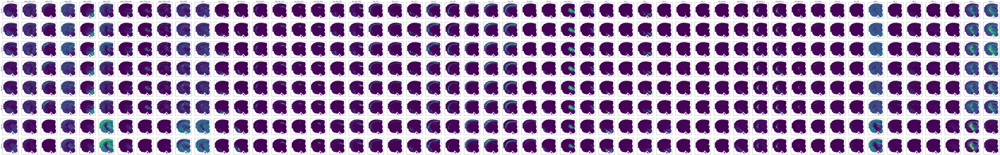

In [5]:
# All cells
ct_to_plot = ct_names
ct_idx = [np.where(ct_names == ct)[0][0] for ct in ct_to_plot]

n_method = len(method_all_names)
n_ct = len(ct_to_plot)
fig, axes = plt.subplots(n_method, n_ct, figsize = (3*n_ct, 3*n_method))

for row_id, (p_inf, name) in enumerate(zip(p_all_list, method_all_names)): 
    axes[row_id][0].set_ylabel(name)
    for i in range(n_ct):
        if row_id == 0:
            axes[row_id][i].set_title(f"{ct_to_plot[i]}")

        axes[row_id][i].scatter(coords[:,0], - coords[:,1], c = p_inf[:, ct_idx[i]], s = 3)

for ax in axes.flatten():
    ax.set_xticks([])
    ax.set_yticks([])

plt.show()

#### Astrocytes

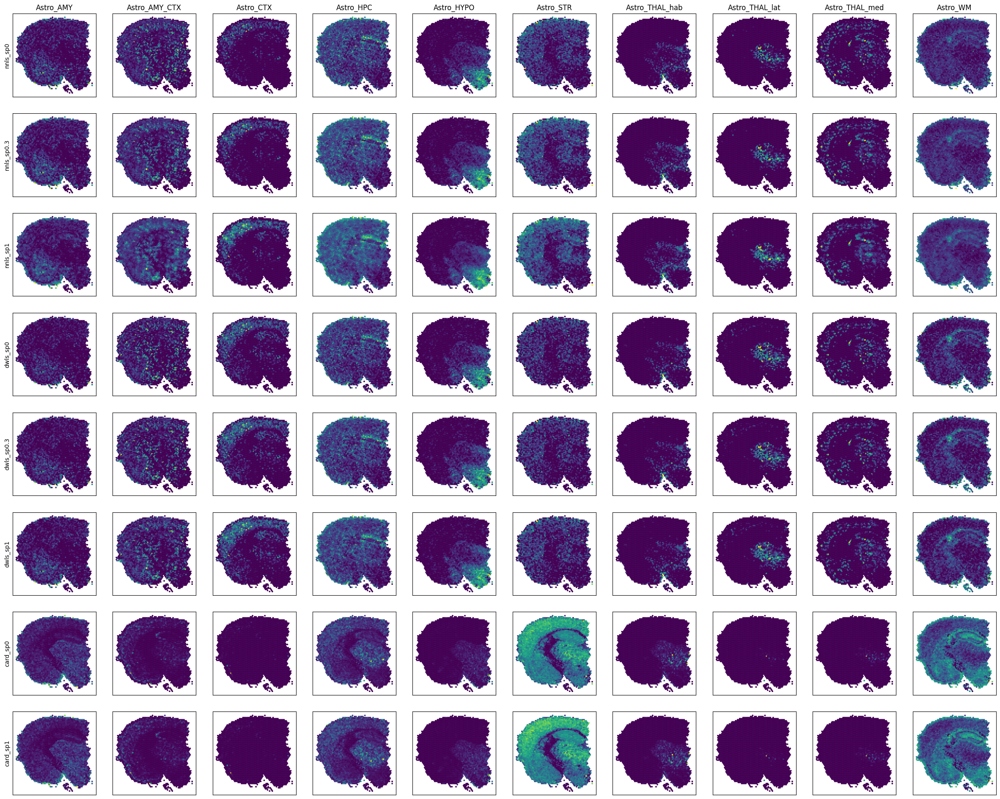

In [6]:
# Astrocytes
ct_to_plot = ct_names[ct_names.str.contains('Astro')]
ct_idx = [np.where(ct_names == ct)[0][0] for ct in ct_to_plot]

n_method = len(method_all_names)
n_ct = len(ct_to_plot)
fig, axes = plt.subplots(n_method, n_ct, figsize = (3*n_ct, 3*n_method))

for row_id, (p_inf, name) in enumerate(zip(p_all_list, method_all_names)): 
    axes[row_id][0].set_ylabel(name)
    for i in range(n_ct):
        if row_id == 0:
            axes[row_id][i].set_title(f"{ct_to_plot[i]}")

        axes[row_id][i].scatter(coords[:,0], - coords[:,1], c = p_inf[:, ct_idx[i]], s = 3)

for ax in axes.flatten():
    ax.set_xticks([])
    ax.set_yticks([])

plt.show()

#### Ext CTX

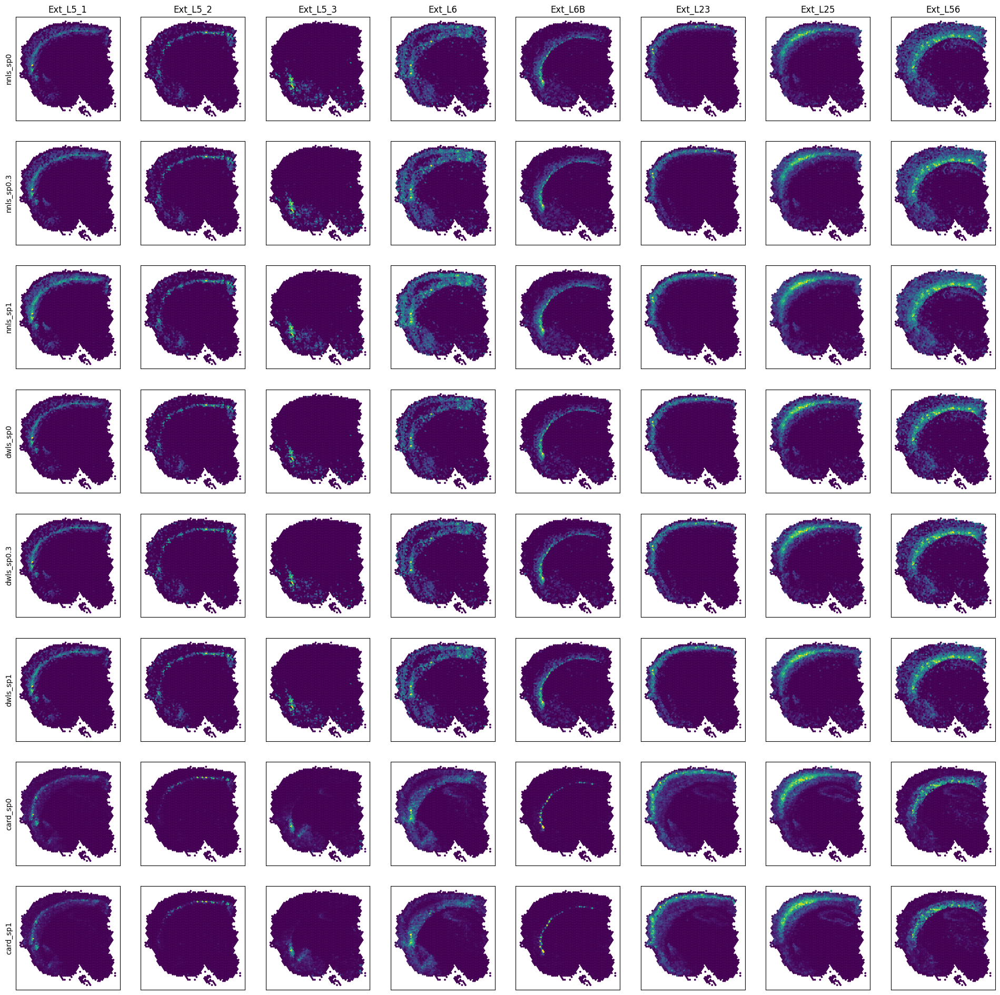

In [7]:
# Excitatory neurons in cortex
ct_to_plot = ct_names[ct_names.str.contains('Ext_L')]
ct_idx = [np.where(ct_names == ct)[0][0] for ct in ct_to_plot]

n_method = len(method_all_names)
n_ct = len(ct_to_plot)
fig, axes = plt.subplots(n_method, n_ct, figsize = (3*n_ct, 3*n_method))

for row_id, (p_inf, name) in enumerate(zip(p_all_list, method_all_names)): 
    axes[row_id][0].set_ylabel(name)
    for i in range(n_ct):
        if row_id == 0:
            axes[row_id][i].set_title(f"{ct_to_plot[i]}")

        axes[row_id][i].scatter(coords[:,0], - coords[:,1], c = p_inf[:, ct_idx[i]], s = 3)

for ax in axes.flatten():
    ax.set_xticks([])
    ax.set_yticks([])

plt.show()

In [8]:
# Merge L5 and L6
l5_ind = np.where(ct_names.str.contains('Ext_L5_'))[0]
l5_inf_list = [p_inf[:,l5_ind].sum(1) for p_inf in p_inf_list]
l6_ind = np.where(ct_names.str.contains('Ext_L6'))[0]
l6_inf_list = [p_inf[:,l5_ind].sum(1) for p_inf in p_inf_list]

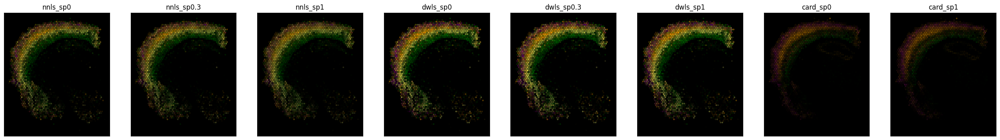

In [9]:
# Excitatory neurons in cortex
#ct_to_plot = ct_names[ct_names.str.contains('Ext_L')]
ct_to_plot = ['Ext_L23', 'Ext_L25', 'Ext_L56']
ct_idx = [np.where(ct_names == ct)[0][0] for ct in ct_to_plot]
colors = ['purple', 'orange', 'green', 'white', 'yellow']
cmaps = [matplotlib.colors.LinearSegmentedColormap.from_list(c, ["black", c])
        for c in colors]


n_method = len(method_all_names)
n_ct = len(ct_to_plot)
fig, axes = plt.subplots(1, n_method, figsize = (4*n_method, 4))

for m_id, (p_inf, name) in enumerate(zip(p_all_list, method_all_names)): 
    axes[m_id].set_title(name)
    
    alpha = p_inf[:, ct_idx]
    #alpha[alpha < 0.1] = 0 
    alpha = (alpha * 2).clip(0, 1)
    #alpha = alpha / (alpha.sum(1, keepdims=True) + 1e-10)
    
    for i in range(n_ct):
        axes[m_id].scatter(coords[:,0], - coords[:,1], c = colors[i],
                         alpha = alpha[:, i], s = 4)

for m_id, (l5,l6) in enumerate(zip(l5_inf_list, l6_inf_list)): 
    l5 = (l5 * 1.5).clip(0,1)
    l6 = (l6 * 1.5).clip(0,1)
    axes[m_id].scatter(coords[:,0], - coords[:,1], c = colors[n_ct],
                       alpha = l5, s = 4)
    axes[m_id].scatter(coords[:,0], - coords[:,1], c = colors[n_ct + 1],
                       alpha = l6, s = 4)

for ax in axes.flatten():
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_facecolor('black')

plt.show()

In [10]:
# Merge L5 and L6
l5_ind = np.where(ct_names.str.contains('Ext_L5_'))[0]
l5_inf_list = [p_inf[:,l5_ind].sum(1) for p_inf in p_all_list]
l6_ind = np.where(ct_names.str.contains('Ext_L6'))[0]
l6_inf_list = [p_inf[:,l5_ind].sum(1) for p_inf in p_all_list]

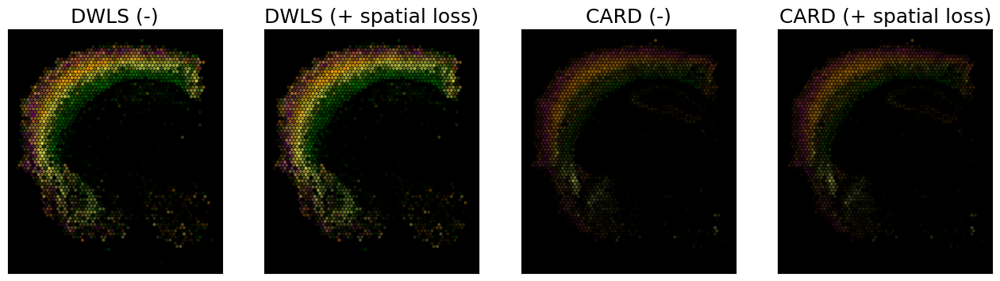

In [11]:
# Excitatory neurons in cortex
#ct_to_plot = ct_names[ct_names.str.contains('Ext_L')]
ct_to_plot = ['Ext_L23', 'Ext_L25', 'Ext_L56']
ct_idx = [np.where(ct_names == ct)[0][0] for ct in ct_to_plot]
colors = ['purple', 'orange', 'green', 'white', 'yellow']
cmaps = [matplotlib.colors.LinearSegmentedColormap.from_list(c, ["black", c])
        for c in colors]
n_ct = len(ct_to_plot)

method_to_plot = ['dwls_sp0', 'dwls_sp1', 'card_sp0', 'card_sp1']
method_to_plot_names = ['DWLS (-)', 'DWLS (+ spatial loss)', 'CARD (-)', 'CARD (+ spatial loss)']
method_idx = [np.where(np.array(method_all_names) == name)[0][0] for name in method_to_plot]
n_method = len(method_to_plot)

fontsize = 18

fig, axes = plt.subplots(1, n_method, figsize = (4*n_method, 4))

for m_id, name in enumerate(method_to_plot_names): 
    axes[m_id].set_title(name, fontsize=fontsize)
    
    alpha = p_all_list[method_idx[m_id]][:, ct_idx]
    alpha = (alpha * 2).clip(0, 1)
    
    for i in range(n_ct):
        axes[m_id].scatter(coords[:,0], - coords[:,1], c = colors[i],
                         alpha = alpha[:, i], s = 4)

    l5 = (l5_inf_list[method_idx[m_id]] * 1.5).clip(0,1)
    l6 = (l6_inf_list[method_idx[m_id]] * 1.5).clip(0,1)
    axes[m_id].scatter(coords[:,0], - coords[:,1], c = colors[n_ct],
                       alpha = l5, s = 4)
    axes[m_id].scatter(coords[:,0], - coords[:,1], c = colors[n_ct + 1],
                       alpha = l6, s = 4)


for ax in axes.flatten():
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_facecolor('black')

plt.show()

#### Ext HPC

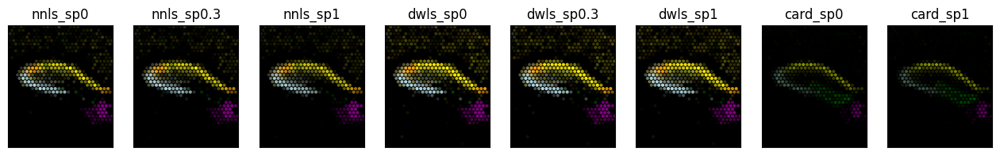

In [12]:
# Excitatory neurons in HPC
ct_to_plot = [f"Ext_Hpc_{n}" for n in ['CA1', 'CA2', 'CA3', 'DG1']] + ["Inh_6"]
colors = ['yellow', 'orange', 'lightblue', 'green', 'purple']
ct_idx = [np.where(ct_names == ct)[0][0] for ct in ct_to_plot]

n_method = len(method_all_names)
n_ct = len(ct_to_plot)
fig, axes = plt.subplots(1, n_method, figsize = (2*n_method, 2))

for m_id, (p_inf, name) in enumerate(zip(p_all_list, method_all_names)): 
    axes[m_id].set_title(name)
    
    alpha = p_inf[:, ct_idx]
    alpha = (alpha * 2).clip(0, 1)
    
    for i in range(n_ct):
        axes[m_id].scatter(coords[:,0], - coords[:,1], c = colors[i],
                         alpha = alpha[:, i], s = 4)

x_min = 0.45*(coords[:,0].max() - coords[:,0].min()) + coords[:,0].min()
x_max = 0.95*(coords[:,0].max() - coords[:,0].min()) + coords[:,0].min()
y_min = 0.45*((-coords[:,1]).max() - (-coords)[:,1].min()) + (-coords)[:,1].min()
y_max = 0.95*((-coords[:,1]).max() - (-coords)[:,1].min()) + (-coords)[:,1].min()

for ax in axes.flatten():
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_xlim([x_min, x_max])
    ax.set_ylim([y_min, y_max])
    ax.set_facecolor('black')

plt.show()

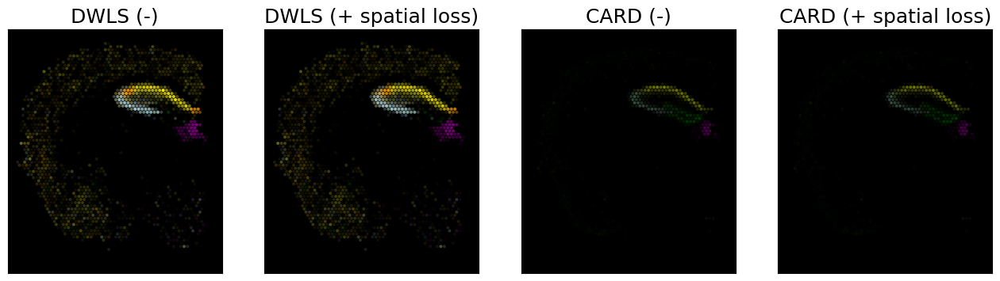

In [13]:
# Excitatory neurons in HPC
ct_to_plot = [f"Ext_Hpc_{n}" for n in ['CA1', 'CA2', 'CA3', 'DG1']] + ["Inh_6"]
colors = ['yellow', 'orange', 'lightblue', 'green', 'purple']
ct_idx = [np.where(ct_names == ct)[0][0] for ct in ct_to_plot]
n_ct = len(ct_to_plot)

method_to_plot = ['dwls_sp0', 'dwls_sp1', 'card_sp0', 'card_sp1']
method_to_plot_names = ['DWLS (-)', 'DWLS (+ spatial loss)', 'CARD (-)', 'CARD (+ spatial loss)']
method_idx = [np.where(np.array(method_all_names) == name)[0][0] for name in method_to_plot]
n_method = len(method_to_plot)

fontsize = 18

fig, axes = plt.subplots(1, n_method, figsize = (4*n_method, 4))

for m_id, name in enumerate(method_to_plot_names): 
    axes[m_id].set_title(name, fontsize=fontsize)
    
    alpha = p_all_list[method_idx[m_id]][:, ct_idx]
    alpha = (alpha * 1.5).clip(0, 1)
    
    for i in range(n_ct):
        axes[m_id].scatter(coords[:,0], - coords[:,1], c = colors[i],
                         alpha = alpha[:, i], s = 4)

x_min = 0.45*(coords[:,0].max() - coords[:,0].min()) + coords[:,0].min()
x_max = 0.95*(coords[:,0].max() - coords[:,0].min()) + coords[:,0].min()
y_min = 0.45*((-coords[:,1]).max() - (-coords)[:,1].min()) + (-coords)[:,1].min()
y_max = 0.95*((-coords[:,1]).max() - (-coords)[:,1].min()) + (-coords)[:,1].min()

for ax in axes.flatten():
    ax.set_xticks([])
    ax.set_yticks([])
    # ax.set_xlim([x_min, x_max])
    # ax.set_ylim([y_min, y_max])
    ax.set_facecolor('black')

plt.show()

### Clustering

In [60]:
from smoother.visualization import cluster_features

clu_inf_list = [cluster_features(p_inf, transform = 'pca', n_neighbors=38, res = 0.9)
                for p_inf in p_inf_list]
clu_card_list = [cluster_features(p_inf, transform = 'pca', n_neighbors=38, res = 1.1)
                 for p_inf in p_card_list]
clu_all_list = clu_inf_list + clu_card_list

/Users/jysumac/miniforge3/envs/smoother_paper/lib/python3.10/site-packages/anndata/_core/anndata.py:522: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
/Users/jysumac/miniforge3/envs/smoother_paper/lib/python3.10/site-packages/anndata/_core/anndata.py:522: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
/Users/jysumac/miniforge3/envs/smoother_paper/lib/python3.10/site-packages/anndata/_core/anndata.py:522: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
/Users/jysumac/miniforge3/envs/smoother_paper/lib/python3.10/site-packages/anndata/_core/anndata.py:522: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
/Users/jysumac/miniforge3/envs/smoother_paper/lib/python3.10/site-packages/anndata/_core/anndata.py:522: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
/Users/jysumac/miniforge3/envs/smoother_paper/lib/python3.10/site

In [61]:
[len(clu.unique()) for clu in clu_all_list]

[15, 16, 17, 17, 16, 17, 16, 16]

In [62]:
def get_cost_matrix(clu1, clu2):
    n_clu1 = len(clu1.unique())
    n_clu2 = len(clu2.unique())
    cm = np.zeros((n_clu1, n_clu2))
    
    for i in range(n_clu1):
        clu_ind = (clu1 == str(i))
        for j in range(n_clu2):
            cm[i, j] = -(clu2[clu_ind] == str(j)).sum()
    return cm
        

def align_clusters(clu_list, ref_ind = None):
    n_clu_list = [len(clu.unique()) for clu in clu_list]
    if ref_ind == None:
        ref_ind = np.argmax(n_clu_list)
    
    clu_aligned_list = []
    for i, clu in enumerate(clu_list):
        if i == ref_ind:
            clu_aligned_list.append(clu)
        else:
            #n_clu = len(clu.unique())
            n_clu = len(clu_list[ref_ind].unique())
            cm = get_cost_matrix(clu, clu_list[ref_ind])
            row_ind, col_ind = sp.optimize.linear_sum_assignment(cm)
            clu_aligned_list.append(
                clu.cat.rename_categories(col_ind).astype(str)
            )
    
    return clu_aligned_list, ref_ind

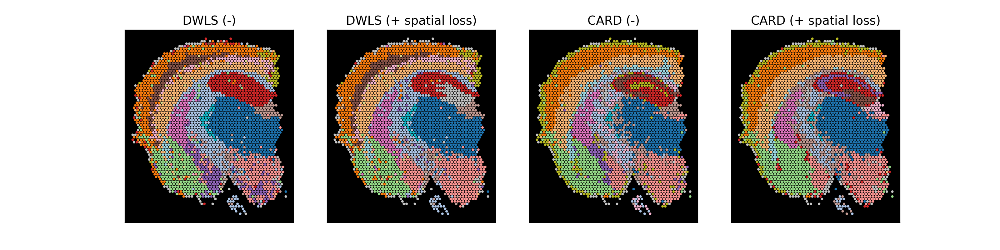

In [63]:
method_to_plot = ['dwls_sp0', 'dwls_sp1', 'card_sp0', 'card_sp1']
method_to_plot_names = ['DWLS (-)', 'DWLS (+ spatial loss)', 
                        'CARD (-)', 'CARD (+ spatial loss)']
method_idx = [np.where(np.array(method_all_names) == name)[0][0] for name in method_to_plot]
n_method = len(method_to_plot)

clu_aligned_list, ref_ind = align_clusters([clu_all_list[i] for i in method_idx])

fontsize = 14

fig, axes = plt.subplots(1, n_method, figsize = (4*n_method, 4))

for row_id, (p_inf, name) in enumerate(zip(p_all_list, method_to_plot_names)): 
    axes[row_id].set_title(name, fontsize=fontsize)

    axes[row_id].scatter(coords[:,0], - coords[:,1], 
                         c = clu_aligned_list[row_id].to_numpy().astype(float), 
                         cmap='tab20', s = 3.5)

for ax in axes.flatten():
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_facecolor('black')

plt.show()